In [191]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from datetime import datetime, timedelta


%matplotlib inline
%config InlineBackend.figure_format='retina'
import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', None)

Загрузим необходимые датасеты

In [192]:
delays = pd.read_csv('Delays_historical.csv')
weather = pd.read_csv('weather_historical.csv')

Так как у нас данные вылетов хранятся с точностью до минут, а погода - с точностью до часов, округлим время вылета (расчетное) до ближайшего часа. 

In [193]:
def hour_rounder(t):
    # Rounds to nearest hour by adding a timedelta hour if minute >= 30
    return (t.replace(second=0, microsecond=0, minute=0, hour=t.hour) + timedelta(hours=t.minute//30))

In [194]:
delays.Datetime = pd.to_datetime(delays.Datetime)

delays['datetime_rounded'] = delays['Datetime'].apply(lambda x: 
                                                      x.replace(minute=0, second=0)
                                                      if x.minute < 30 else x.replace(hour=min(x.hour + 1, 23),
                                                      minute=0, second=0) )

In [195]:
delays.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264272 entries, 0 to 264271
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Unnamed: 0           264272 non-null  int64         
 1   Carrier Code         264272 non-null  object        
 2   Flight               264272 non-null  int64         
 3   Destination airport  264272 non-null  object        
 4   Scheduled time       264272 non-null  object        
 5   Delay                264272 non-null  int64         
 6   Date                 264272 non-null  object        
 7   Datetime             264272 non-null  datetime64[ns]
 8   datetime_rounded     264272 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(3), object(4)
memory usage: 18.1+ MB


In [196]:
delays

,Unnamed: 0,Carrier Code,Flight,Destination airport,Scheduled time,Delay,Date,Datetime,datetime_rounded
0,0,AS,27,SEA,09:45,159,2022-01-01,2022-01-01 09:45:00,2022-01-01 10:00:00
1,1,AS,39,SEA,17:29,23,2022-01-01,2022-01-01 17:29:00,2022-01-01 17:00:00
2,2,AS,139,ANC,07:05,115,2022-01-01,2022-01-01 07:05:00,2022-01-01 07:00:00
3,3,AS,1011,SEA,07:45,3,2022-01-01,2022-01-01 07:45:00,2022-01-01 08:00:00
4,4,AS,1013,SEA,15:35,37,2022-01-01,2022-01-01 15:35:00,2022-01-01 16:00:00
...,...,...,...,...,...,...,...,...,...
264267,264267,UA,2669,EWR,15:45,0,2021-12-31,2021-12-31 15:45:00,2021-12-31 16:00:00
264268,264268,UA,2677,IAD,13:00,-5,2021-12-31,2021-12-31 13:00:00,2021-12-31 13:00:00
264269,264269,UA,2678,IAH,12:45,10,2021-12-31,2021-12-31 12:45:00,2021-12-31 13:00:00
264270,264270,UA,2682,IAH,14:05,1,2021-12-31,2021-12-31 14:05:00,2021-12-31 14:00:00


Как видим, дата округлилась корректно. 

In [197]:
weather.datetime = pd.to_datetime(weather.datetime)

Поджойним данные вылетов с погодой по полю с округленным временем

In [198]:
joined_data = delays.merge(weather, how='left', left_on='datetime_rounded', right_on='datetime' )

In [199]:
print('Поджойненные данные: ', len(joined_data))
print('Данные погоды: ', len(weather))
print('Данные задержек: ', len(delays))



Поджойненные данные:  264272
Данные погоды:  10753
Данные задержек:  264272


Как видим, строки не размножились и джойн произошел корректно.
Уберем лишние колонки

In [200]:
joined_data = joined_data.drop(columns = ['Unnamed: 0_x', 'Unnamed: 0_y', 'datetime'])
joined_data = joined_data.sort_values(by=['Datetime'])

In [201]:
joined_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264272 entries, 254659 to 197027
Data columns (total 31 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Carrier Code         264272 non-null  object        
 1   Flight               264272 non-null  int64         
 2   Destination airport  264272 non-null  object        
 3   Scheduled time       264272 non-null  object        
 4   Delay                264272 non-null  int64         
 5   Date                 264272 non-null  object        
 6   Datetime             264272 non-null  datetime64[ns]
 7   datetime_rounded     264272 non-null  datetime64[ns]
 8   name                 241594 non-null  object        
 9   temp                 264272 non-null  float64       
 10  feelslike            264272 non-null  float64       
 11  dew                  264272 non-null  float64       
 12  humidity             264272 non-null  float64       
 13  precip   

На всякий случай сохраним

In [63]:
joined_data.to_csv("joined_historical_data.csv")

In [104]:
joined_data.head()

,Carrier Code,Flight,Destination airport,Scheduled time,Delay,Date,Datetime,datetime_rounded,name,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon
254659,UA,2352,DEN,05:00,-1,2021-11-01,2021-11-01 05:00:00,2021-11-01 05:00:00,O'Hare Chicago,36.1,30.7,28.9,74.81,0.0,0.0,NaN,0.0,0.0,NaN,6.7,288.0,1024.3,0.0,9.9,NaN,NaN,NaN,NaN,Clear,clear-night
45939,AA,2341,MIA,05:00,0,2021-11-01,2021-11-01 05:00:00,2021-11-01 05:00:00,O'Hare Chicago,36.1,30.7,28.9,74.81,0.0,0.0,NaN,0.0,0.0,NaN,6.7,288.0,1024.3,0.0,9.9,NaN,NaN,NaN,NaN,Clear,clear-night
197038,NK,2,FLL,05:10,17,2021-11-01,2021-11-01 05:10:00,2021-11-01 05:00:00,O'Hare Chicago,36.1,30.7,28.9,74.81,0.0,0.0,NaN,0.0,0.0,NaN,6.7,288.0,1024.3,0.0,9.9,NaN,NaN,NaN,NaN,Clear,clear-night
45917,AA,1784,CLT,05:10,-4,2021-11-01,2021-11-01 05:10:00,2021-11-01 05:00:00,O'Hare Chicago,36.1,30.7,28.9,74.81,0.0,0.0,NaN,0.0,0.0,NaN,6.7,288.0,1024.3,0.0,9.9,NaN,NaN,NaN,NaN,Clear,clear-night
45831,AA,328,DFW,05:15,-4,2021-11-01,2021-11-01 05:15:00,2021-11-01 05:00:00,O'Hare Chicago,36.1,30.7,28.9,74.81,0.0,0.0,NaN,0.0,0.0,NaN,6.7,288.0,1024.3,0.0,9.9,NaN,NaN,NaN,NaN,Clear,clear-night


In [334]:
joined_data.describe()

,Flight,Delay,temp,feelslike,dew,humidity,precip,precipprob,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk
count,264272.000000,264272.000000,264272.000000,264272.000000,264272.000000,264272.000000,264272.000000,264272.000000,261934.000000,264272.000000,224658.000000,264272.000000,264272.000000,264272.000000,264272.000000,264272.000000,246255.000000,220184.000000,246255.000000,198291.000000
mean,2825.062678,11.276140,50.673271,47.519493,36.990746,61.021332,0.009039,8.722453,0.002245,0.365272,19.158728,10.973647,190.660548,1016.111866,68.368226,9.897700,234.052852,0.942254,2.321106,12.342744
std,1603.053525,49.692125,23.722329,27.088651,21.407599,16.380861,0.108882,28.216433,0.019347,1.264833,10.065674,5.462692,101.487075,7.395601,32.467687,2.348201,261.533746,0.948302,2.642278,12.319764
min,2.000000,-29.000000,-4.900000,-17.700000,-14.000000,15.150000,0.000000,0.000000,0.000000,0.000000,0.900000,0.000000,0.000000,986.400000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
25%,1602.750000,-5.000000,33.200000,24.800000,20.000000,48.830000,0.000000,0.000000,0.000000,0.000000,10.700000,7.200000,101.000000,1011.200000,45.000000,9.900000,20.000000,0.200000,0.000000,10.000000
50%,2613.000000,-2.000000,50.100000,50.100000,37.100000,61.320000,0.000000,0.000000,0.000000,0.000000,19.200000,10.300000,209.000000,1015.800000,81.800000,9.900000,145.000000,0.600000,1.000000,10.000000
75%,3869.000000,7.000000,73.000000,73.000000,56.700000,73.410000,0.000000,0.000000,0.000000,0.000000,25.100000,14.100000,271.000000,1020.600000,98.900000,9.900000,352.000000,1.400000,4.000000,10.000000
max,9679.000000,5995.000000,98.300000,105.400000,75.900000,96.630000,3.887000,100.000000,0.470000,8.920000,69.600000,43.300000,360.000000,1037.400000,100.000000,16.000000,1151.000000,4.100000,10.000000,100.000000


Убедимся, что в датах нет пробелов

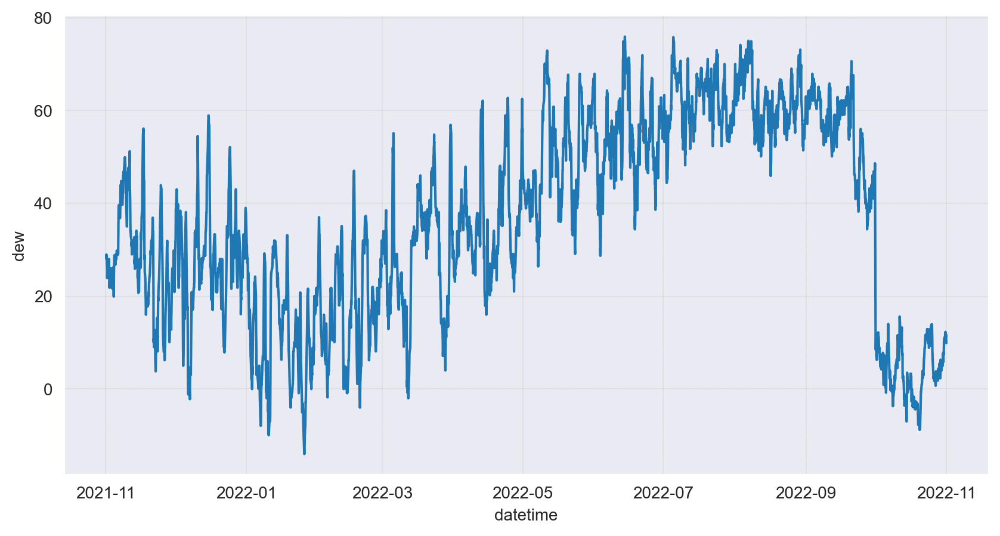

In [100]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(joined_data.datetime_rounded, joined_data.dew)

plt.grid(color = 'grey',   
        linewidth = 0.1,    
        linestyle = '--')    


plt.xlabel('datetime')
plt.ylabel('dew')
plt.show()

Два наблюдения. Во-первых, все данные на месте, а во-вторых, точка росы зимой ниже - ожидаемо, так как влажность воздуха выше.

Посмотрим, как распределена целевая переменная - время задержки в минутах.

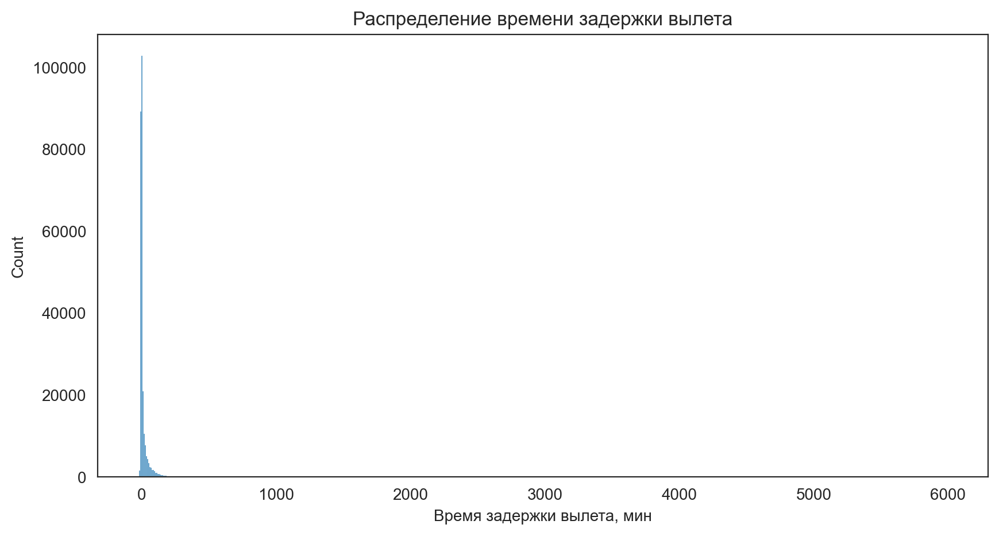

In [216]:
sns.set_style("white")
plt.figure(figsize=(10, 5))

sns.histplot(joined_data.Delay, bins=700)

plt.xlabel('Время задержки вылета, мин')
plt.title('Распределение времени задержки вылета')
plt.show()

Посмотрим поближе

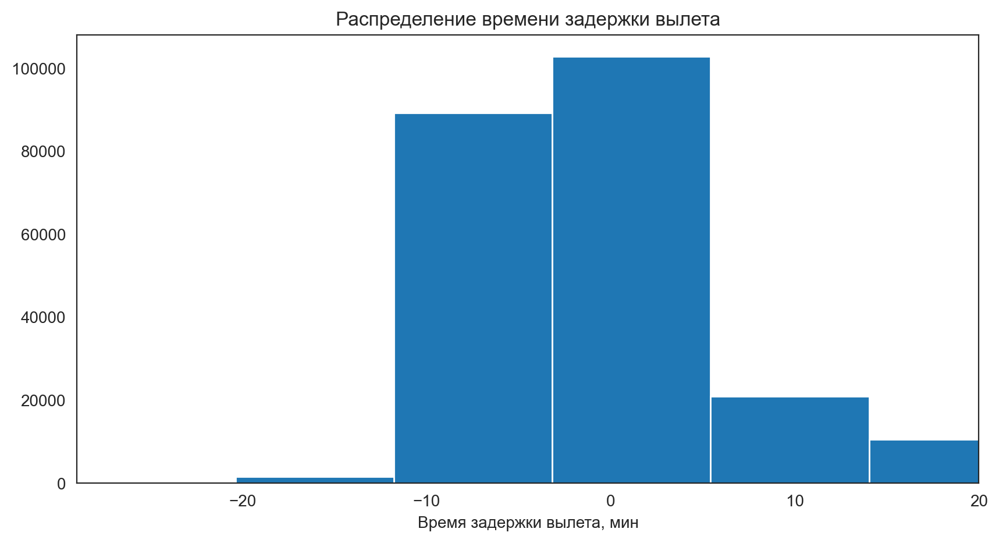

In [220]:
sns.set_style("white")
plt.figure(figsize=(10, 5))

count, bins, ignored = plt.hist(joined_data.Delay, bins=700)

plt.xlim(min(joined_data.Delay), 20)
plt.xlabel('Время задержки вылета, мин')
plt.title('Распределение времени задержки вылета')
plt.show()

Во-первых есть отрицательные значения задержки - самолет вылетел раньше. 

In [342]:
print ("Доля вылетов с опережением ", len(joined_data[joined_data.Delay < 0]) / len(joined_data))
print ("Доля вылетов вовремя", len(joined_data[joined_data.Delay == 0]) / len(joined_data))
print ("Доля вылетов с опозданием ", len(joined_data[joined_data.Delay > 0]) / len(joined_data))

Доля вылетов с опережением  0.5742038505781921
Доля вылетов вовремя 0.0757250105951444
Доля вылетов с опозданием  0.35007113882666346


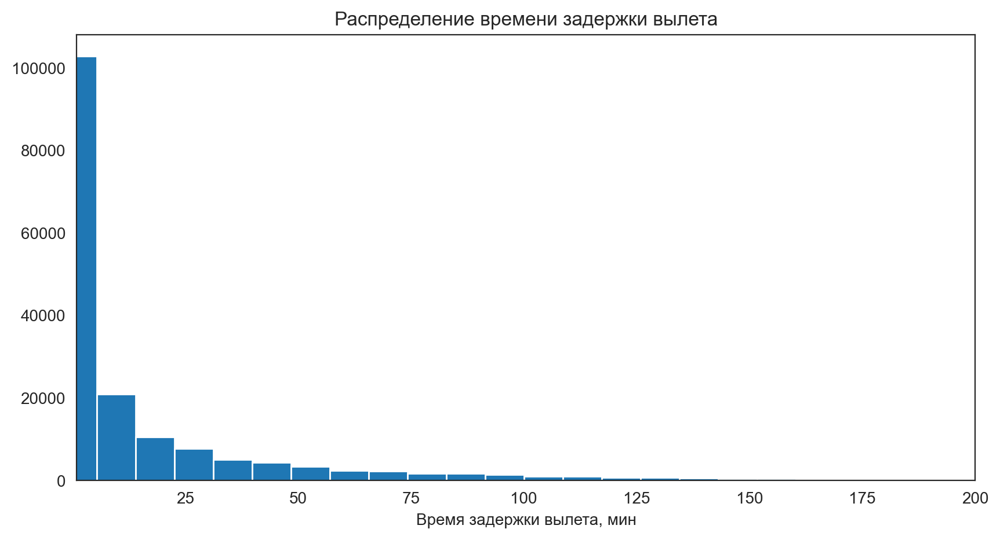

In [210]:
sns.set_style("white")
plt.figure(figsize=(10, 5))

count, bins, ignored = plt.hist(joined_data.Delay, bins=700)

plt.xlim(1, 200)
plt.xlabel('Время задержки вылета, мин')
plt.title('Распределение времени задержки вылета')
plt.show()

Распределение экспоненциальное, что ожидаемо (а если брать вылеты раньше - то даже логнормальное)

Посмотрим на корелляции

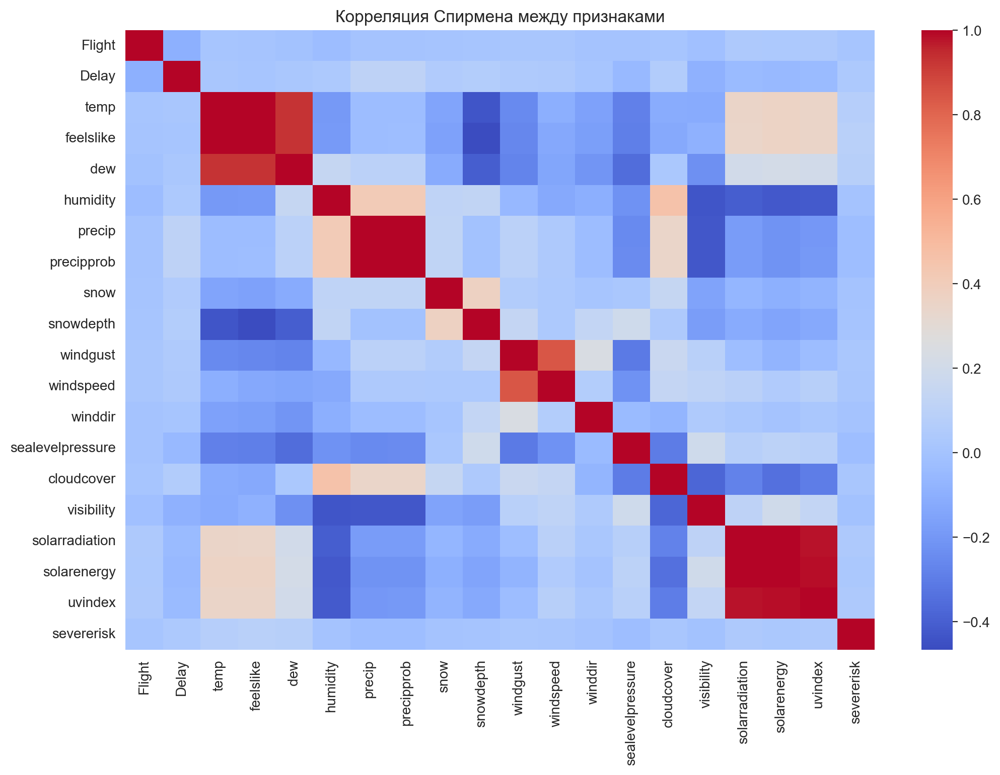

In [121]:
plt.figure(figsize=(12, 8))
sns.heatmap(joined_data.corr(method="spearman"), cmap="coolwarm");
plt.title("Корреляция Спирмена между признаками");

Есть сильная корелляция между показателями солнечной энергии, осадками и вероятностью осадков, видимостью и туманностью, глубиной снега и температурой/точкой росы - что предсказуемо
Чуть менее выраженная корелляция есть между температурой и "ощущается как", осадками/туманностью и облачностью, показателями солнечной энергии и температурой. 

Заметим, что сильной корелляции между целевым показателем - задержкой и каким-либо признаком не заметно. 

Построим перекрестные зависимости

In [122]:
g = sns.PairGrid(joined_data)
g.map_offdiag(sns.scatterplot)
g.map_diag(sns.histplot);

Каких-то новых зависимостей не заметно, все вышенаписанное актуально

 Посмотрим на корелляцию задержек с некоторыми категориальными признаками

In [126]:
categorical_cols = joined_data.select_dtypes(include=['object'])
categorical_cols = categorical_cols.drop(columns=['Date', 'name'])
categorical_cols

,Carrier Code,Destination airport,Scheduled time,preciptype,conditions,icon
254659,UA,DEN,05:00,NaN,Clear,clear-night
45939,AA,MIA,05:00,NaN,Clear,clear-night
197038,NK,FLL,05:10,NaN,Clear,clear-night
45917,AA,CLT,05:10,NaN,Clear,clear-night
45831,AA,DFW,05:15,NaN,Clear,clear-night
...,...,...,...,...,...,...
254505,UA,IND,21:36,NaN,Clear,clear-night
254464,UA,CMH,21:39,NaN,Clear,clear-night
254416,UA,CVG,21:42,NaN,Clear,clear-night
197032,NK,LAS,21:45,NaN,Clear,clear-night


In [128]:
from sklearn.preprocessing import LabelEncoder

cat_le = categorical_cols.apply(LabelEncoder().fit_transform)
cat_le['Delay'] = joined_data['Delay']
#finding important features from categorical values
correlation_cat = cat_le.corr()
correlation_cat.sort_values(["Delay"], ascending = False, inplace = True)
correlation_cat.Delay

Delay                  1.000000
Scheduled time         0.076430
conditions             0.063073
icon                   0.035491
Destination airport    0.005149
Carrier Code          -0.030269
preciptype            -0.074658
Name: Delay, dtype: float64

Еще раз посмотрим на числовые признаки, потому что можем!

In [129]:
numeric_cols = joined_data.select_dtypes(exclude=['object'])

correlation_num = numeric_cols.corr()
correlation_num.sort_values(["Delay"], ascending = False, inplace = True)
correlation_num.Delay

Delay               1.000000
precipprob          0.081510
humidity            0.039331
dew                 0.036553
snowdepth           0.033509
cloudcover          0.031103
temp                0.025828
feelslike           0.021474
windgust            0.021355
severerisk          0.021113
precip              0.016564
snow                0.014228
windspeed           0.013138
winddir             0.009813
solarradiation     -0.026670
solarenergy        -0.026704
uvindex            -0.027193
Flight             -0.031602
sealevelpressure   -0.035177
visibility         -0.060797
Name: Delay, dtype: float64

Визуализируем

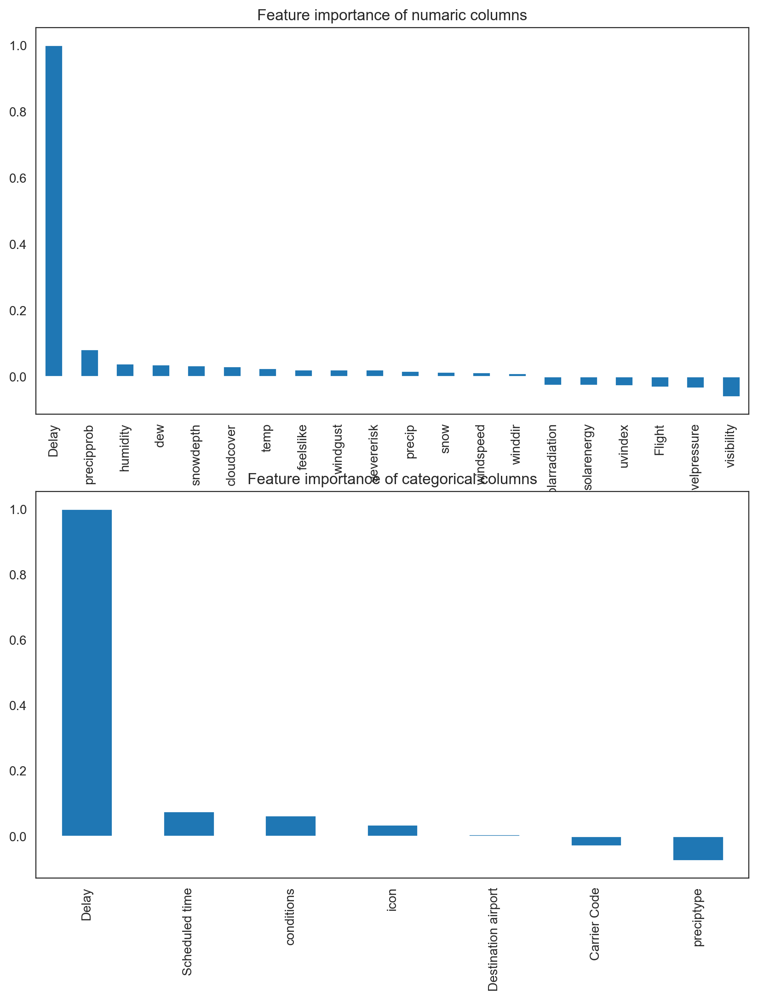

In [131]:
fig, axarr = plt.subplots(2, 1, figsize = (10, 12))
correlation_num.Delay.plot.bar(ax=axarr[0])
correlation_cat.Delay.plot.bar(ax=axarr[1])
axarr[0].set_title("Feature importance of numeric columns")
axarr[1].set_title("Feature importance of categorical columns");

Собственно наибольшая корелляция у задержек есть с видимостью и осадками, что ожидаемо

#### Подробнее посмотрим за зависимость целевой переменной от признаков с наибольшей корелляцией

In [152]:
filtered = joined_data[joined_data.Delay > 0]
grouped_cnt_vis = filtered.groupby(by=['visibility'], as_index=False).count()


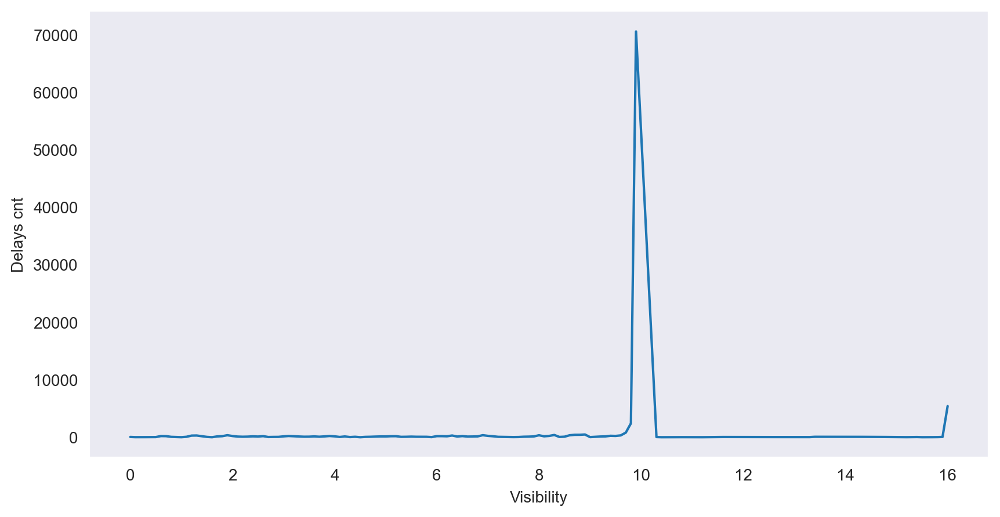

In [157]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_cnt_vis.visibility, grouped_cnt_vis.Delay)
plt.ylabel("Delays cnt")
plt.xlabel("Visibility")

plt.show()

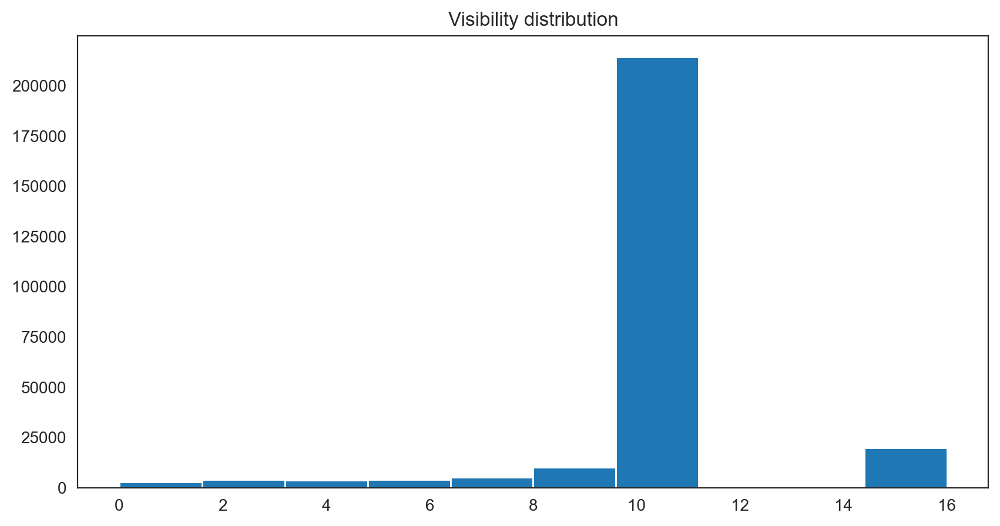

In [160]:
sns.set_style("white")
plt.figure(figsize=(10, 5))
plt.hist(joined_data.visibility)
plt.title("Visibility distribution")

plt.show()

С одной стороны, чаще всего рейсы задерживают при видимости около 10. Однако это в целом наиболее частое значение видимости, так что такой вывод некорректен. 

In [182]:
grouped_vis = joined_data.groupby(by=['visibility'], as_index=False).count()
grouped_vis = grouped_vis[['visibility', 'Date']]
grouped_vis = grouped_vis.merge(grouped_cnt_vis, on='visibility')
grouped_vis['Diff'] =   grouped_vis['temp'] / grouped_vis['Date_x']

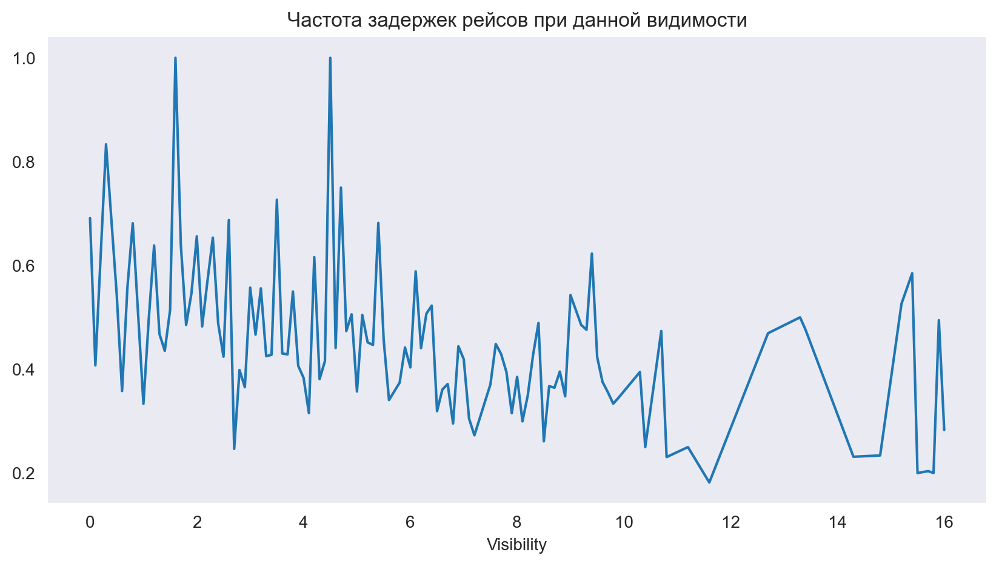

In [188]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_vis.visibility, grouped_vis.Diff)
plt.title("Частота задержек рейсов при данной видимости")
plt.xlabel('Visibility')

plt.show()

Теперь хорошо заметно,что при низкой видимости рейсы задерживаются чаще. 

Посмотрим на вероятность осадков

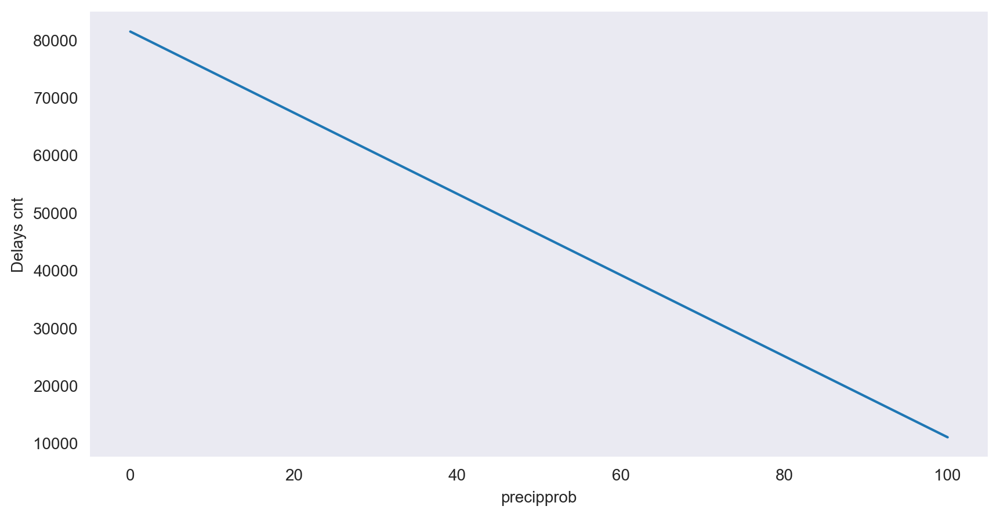

In [223]:
grouped_cnt_precipprob = filtered.groupby(by=['precipprob'], as_index=False).count()

sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_cnt_precipprob.precipprob, grouped_cnt_precipprob.Delay)
plt.ylabel("Delays cnt")
plt.xlabel("precipprob")

plt.show()


In [224]:
joined_data.precipprob.unique()

array([  0., 100.])

У этого признака всего два значения - скорее всего он просто не заполнялся корректно, поэтому его рассматривать нет смысла

Посмотрим на preciptype

In [227]:
grouped_cnt_preciptype = filtered.groupby(by=['preciptype'], as_index=False).count()

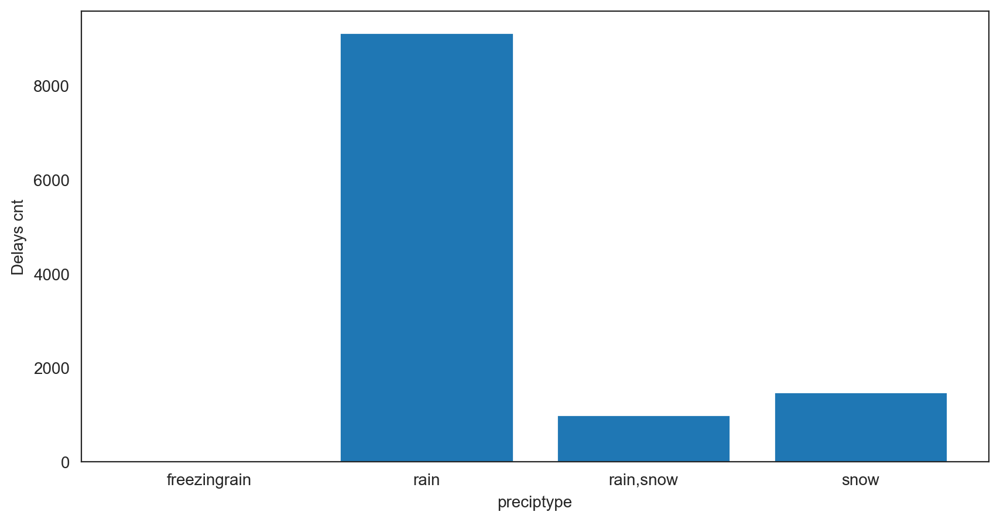

In [233]:
sns.set_style("white")
plt.figure(figsize=(10, 5))
plt.bar(grouped_cnt_preciptype.preciptype, grouped_cnt_preciptype.Delay, )
plt.ylabel("Delays cnt")
plt.xlabel("preciptype")

plt.show()

Чтобы не допустить ложных выводов, как с видимостью, посмотрим на доли

In [238]:
grouped_preciptype = joined_data.groupby(by=['preciptype'], as_index=False).count()
grouped_preciptype = grouped_preciptype[['preciptype', 'Date']]
grouped_preciptype = grouped_preciptype.merge(grouped_cnt_preciptype, on='preciptype')
grouped_preciptype['Diff'] =   grouped_preciptype['temp'] / grouped_preciptype['Date_x']

In [239]:
grouped_preciptype

,preciptype,Date_x,Carrier Code,Flight,Destination airport,Scheduled time,Delay,Date_y,Datetime,datetime_rounded,name,temp,feelslike,dew,humidity,precip,precipprob,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,Diff
0,freezingrain,34,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,0.735294
1,rain,19716,9128,9128,9128,9128,9128,9128,9128,9128,8698,9128,9128,9128,9128,9128,9128,9128,9128,8710,9128,9128,9128,9128,9128,8909,7761,8909,8303,9128,8698,0.462974
2,"rain,snow",1804,998,998,998,998,998,998,998,998,688,998,998,998,998,998,998,998,998,622,998,998,998,998,998,975,921,975,543,998,688,0.553215
3,snow,2600,1484,1484,1484,1484,1484,1484,1484,1484,1483,1484,1484,1484,1484,1484,1484,1484,1484,1138,1484,1484,1484,1484,1484,1327,1135,1327,1018,1484,1483,0.570769


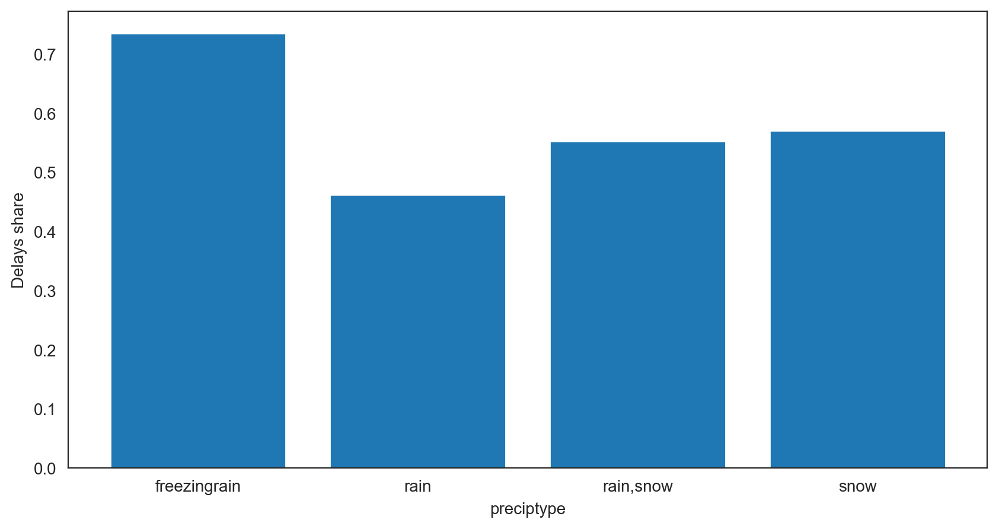

In [241]:
sns.set_style("white")
plt.figure(figsize=(10, 5))
plt.bar(grouped_preciptype.preciptype, grouped_preciptype.Diff)
plt.ylabel("Delays share")
plt.xlabel("preciptype")

plt.show()

Теперь понятно, что во время ледяного дождя (гололед и тд) полеты задерживают чаще

Изучим зависимость от запланированного времени отправления

In [243]:
grouped_cnt_sctime = filtered.groupby(by=['datetime_rounded'], as_index=False).count()


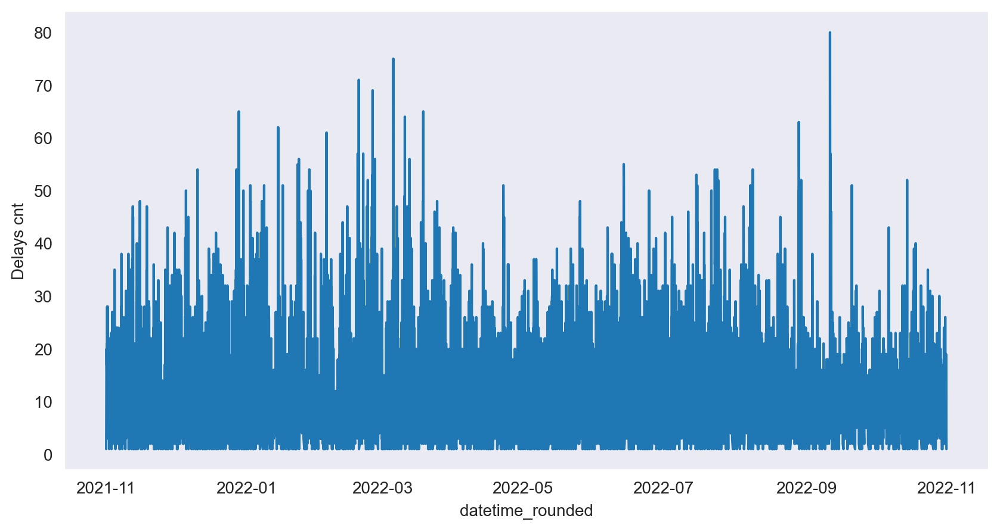

In [246]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_cnt_sctime.datetime_rounded, grouped_cnt_sctime.Delay)
plt.ylabel("Delays cnt")
plt.xlabel("datetime_rounded")

plt.show()

Явной сезонности незаметно. Но возможно летом задержек чуть меньше из-за более сухой погоды

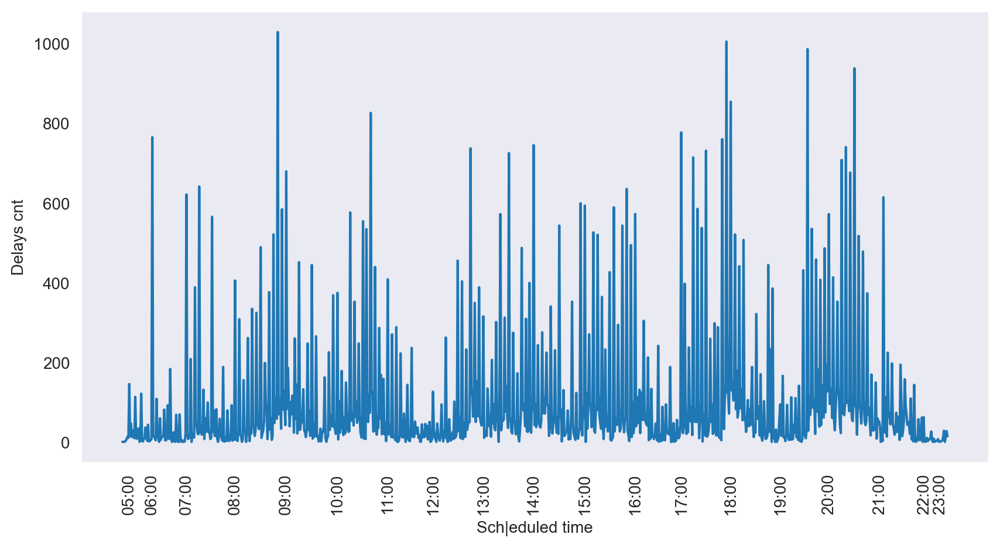

In [260]:
grouped_cnt_sctime = filtered.groupby(by=['Scheduled time'], as_index=False).count()

sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_cnt_sctime['Scheduled time'], grouped_cnt_sctime.Delay)
plt.ylabel("Delays cnt")
plt.xlabel("Sch|eduled time")

labels = np.array(grouped_cnt_sctime['Scheduled time'])
xticks = []
for i in range(len(labels)):
    if labels[i].endswith('00'):
        xticks.append(labels[i])

plt.xticks(xticks, rotation=90)
plt.show()


In [261]:
grouped_sctime= joined_data.groupby(by=['Scheduled time'], as_index=False).count()
grouped_sctime = grouped_sctime[['Scheduled time', 'Date']]
grouped_sctime = grouped_sctime.merge(grouped_cnt_sctime, on='Scheduled time')
grouped_sctime['Diff'] =   grouped_sctime['temp'] / grouped_sctime['Date_x']

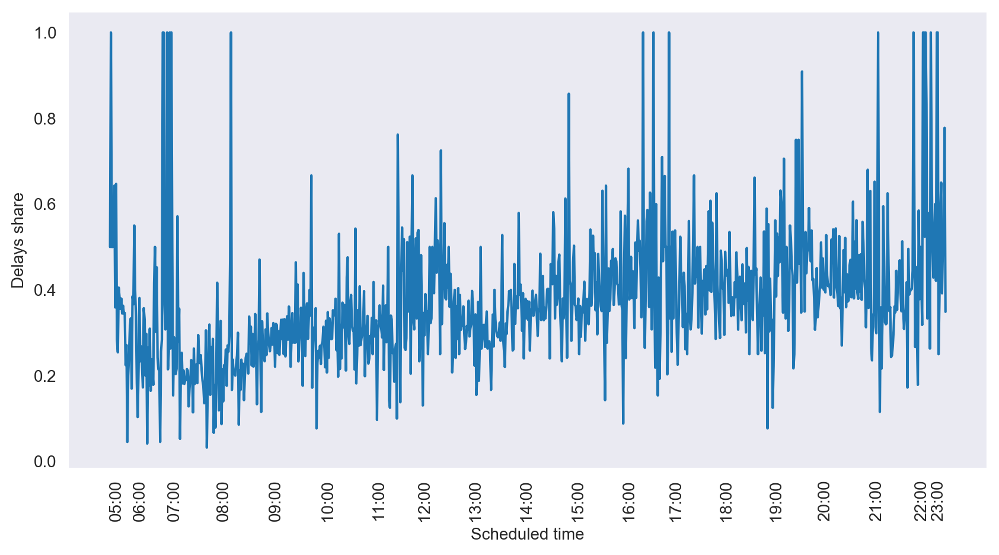

In [262]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_sctime['Scheduled time'], grouped_sctime.Diff)
plt.ylabel("Delays share")
plt.xlabel("Scheduled time")

labels = np.array(grouped_cnt_sctime['Scheduled time'])
xticks = []
for i in range(len(labels)):
    if labels[i].endswith('00'):
        xticks.append(labels[i])

plt.xticks(xticks, rotation=90)
plt.show()

Заметен тренд, утренние рейсы задерживают реже, чем вечерние и ночные

Изучим зависимость от скорости ветра

In [265]:
grouped_cnt_wspeed = filtered.groupby(by=['windspeed'], as_index=False).count()


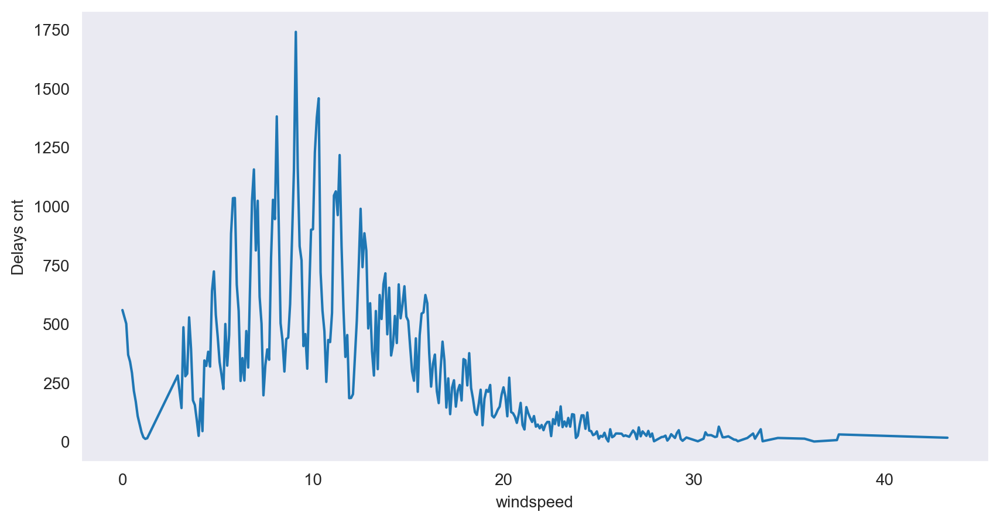

In [266]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_cnt_wspeed.windspeed, grouped_cnt_wspeed.Delay)
plt.ylabel("Delays cnt")
plt.xlabel("windspeed")

plt.show()

In [267]:
grouped_wspeed = joined_data.groupby(by=['windspeed'], as_index=False).count()
grouped_wspeed = grouped_wspeed[['windspeed', 'Date']]
grouped_wspeed = grouped_wspeed.merge(grouped_cnt_wspeed, on='windspeed')
grouped_wspeed['Diff'] =   grouped_wspeed['temp'] / grouped_wspeed['Date_x']

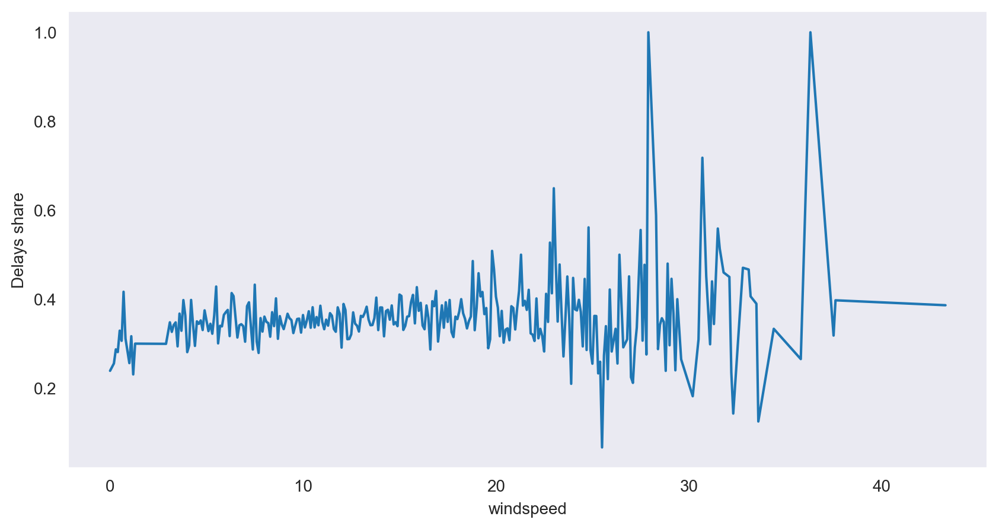

In [271]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
plt.plot(grouped_wspeed['windspeed'], grouped_wspeed.Diff)
plt.ylabel("Delays share")
plt.xlabel("windspeed")

plt.show()

При скорости ветра до 17м/с полеты задерживают примерно равномерно, а при ее усилении задержек значительно больше. Но важно отметить, что и данных со скоростью > 28 м/с довольно мало, поэтому вторая часть графика с большой дисперсией.

Ну и узнаем, что такое icon и какие значения оно принимает?

In [294]:
joined_data.icon.unique()

array(['clear-night', 'partly-cloudy-night', 'partly-cloudy-day',
       'cloudy', 'clear-day', 'rain', nan, 'snow', 'wind'], dtype=object)

По всей видимости, это какую картинку/иконку нарисовать к текущему прогнозу погоды))

windgust- "порывы ветра до ... m/c"

### Что по пропускам?

In [272]:
joined_data.isnull().sum()

Carrier Code                0
Flight                      0
Destination airport         0
Scheduled time              0
Delay                       0
Date                        0
Datetime                    0
datetime_rounded            0
name                    22678
temp                        0
feelslike                   0
dew                         0
humidity                    0
precip                      0
precipprob                  0
preciptype             240118
snow                     2338
snowdepth                   0
windgust                39614
windspeed                   0
winddir                     0
sealevelpressure            0
cloudcover                  0
visibility                  0
solarradiation          18017
solarenergy             44088
uvindex                 18017
severerisk              65981
conditions                  0
icon                    22678
stations                22678
dtype: int64

Что нас не интересует: icon, stations, name

Посмотрим, когда preciptype is nan ?

In [280]:
null_precip = joined_data[joined_data.preciptype.isnull()]
null_precip.precipprob.unique()

array([0.])

По всей видимости, если preciptype пропущен, то осадков просто не было и пропуски можно смело заменить на "no precip"

Что по snow?

In [282]:
null_snow = joined_data[joined_data.snow.isnull()]
null_snow.precipprob.unique()

array([0.])

In [283]:
null_snow.snowdepth.unique()

array([3.74, 3.7 , 3.62, 3.33, 3.5 , 3.43, 3.39, 3.31, 3.27, 3.23, 3.19,
       3.15, 3.11, 3.03, 2.95, 3.22, 2.8 , 2.76, 2.64, 2.6 , 2.15, 2.56,
       2.24, 2.09, 1.02, 0.98, 0.91, 0.67, 0.39, 0.04, 1.36, 0.  , 1.25,
       0.12])

In [287]:
null_snow.Date.unique()

array(['2022-02-07', '2022-02-08', '2022-02-09', '2022-02-10'],
      dtype=object)

По каким-то внешним причинам наличие снега не регистрировалась в вышеуказанные дни.

Что по порывам ветра?

In [291]:
null_wgust = joined_data[joined_data.windgust.isnull()]
null_wgust.Date.unique()

array(['2021-11-01', '2021-11-02', '2021-11-03', '2021-11-04',
       '2021-11-05', '2021-11-06', '2021-11-07', '2021-11-08',
       '2021-11-09', '2021-11-10', '2021-11-11', '2021-11-13',
       '2021-11-14', '2021-11-15', '2021-11-16', '2021-11-17',
       '2021-11-19', '2021-11-20', '2021-11-21', '2021-11-22',
       '2021-11-23', '2021-11-24', '2021-11-25', '2021-11-26',
       '2021-11-27', '2021-11-28', '2021-11-29', '2021-11-30',
       '2021-12-01', '2021-12-02', '2021-12-03', '2021-12-04',
       '2021-12-05', '2021-12-06', '2021-12-07', '2021-12-08',
       '2021-12-09', '2021-12-10', '2021-12-11', '2021-12-12',
       '2021-12-13', '2021-12-14', '2021-12-17', '2021-12-18',
       '2021-12-19', '2021-12-20', '2021-12-21', '2021-12-22',
       '2021-12-23', '2021-12-24', '2021-12-25', '2021-12-26',
       '2021-12-27', '2021-12-28', '2021-12-29', '2021-12-30',
       '2021-12-31', '2022-01-02', '2022-01-03', '2022-01-04',
       '2022-01-06', '2022-01-07', '2022-01-08', '2022-

In [308]:
wgust_notnull = joined_data[joined_data.Date <= '2022-01-31']
wgust_notnull = wgust_notnull[wgust_notnull.windgust.isnull() == False]

In [310]:
wgust_notnull[wgust_notnull.severerisk == 0]

,Carrier Code,Flight,Destination airport,Scheduled time,Delay,Date,Datetime,datetime_rounded,name,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations


Первые три месяца отсутствие порывовов ветра обозначалось пропуском, позже стало обозначаться 0.0 

Severerisk - это вероятность погодной опасности (шторма, гололеда и тд, о чем любят писать мчс по смс))

In [296]:
null_severerisk = joined_data[joined_data.severerisk.isnull()]
null_severerisk.Date.unique()

array(['2021-11-01', '2021-11-02', '2021-11-03', '2021-11-04',
       '2021-11-05', '2021-11-06', '2021-11-07', '2021-11-08',
       '2021-11-09', '2021-11-10', '2021-11-11', '2021-11-12',
       '2021-11-13', '2021-11-14', '2021-11-15', '2021-11-16',
       '2021-11-17', '2021-11-18', '2021-11-19', '2021-11-20',
       '2021-11-21', '2021-11-22', '2021-11-23', '2021-11-24',
       '2021-11-25', '2021-11-26', '2021-11-27', '2021-11-28',
       '2021-11-29', '2021-11-30', '2021-12-01', '2021-12-02',
       '2021-12-03', '2021-12-04', '2021-12-05', '2021-12-06',
       '2021-12-07', '2021-12-08', '2021-12-09', '2021-12-10',
       '2021-12-11', '2021-12-12', '2021-12-13', '2021-12-14',
       '2021-12-15', '2021-12-16', '2021-12-17', '2021-12-18',
       '2021-12-19', '2021-12-20', '2021-12-21', '2021-12-22',
       '2021-12-23', '2021-12-24', '2021-12-25', '2021-12-26',
       '2021-12-27', '2021-12-28', '2021-12-29', '2021-12-30',
       '2021-12-31', '2022-01-01', '2022-01-02', '2022-

severerisk вообще не логировался первые три месяца

Разберемся с показателями солнца

In [297]:
null_solarradiation = joined_data[joined_data.solarradiation.isnull()]
null_solarradiation.Date.unique()

array(['2021-11-01', '2021-11-02', '2021-11-03', '2021-11-04',
       '2021-11-05', '2021-11-06', '2021-11-07', '2021-11-08',
       '2021-11-09', '2021-11-10', '2021-11-11', '2021-11-12',
       '2021-11-13', '2021-11-14', '2021-11-15', '2021-11-16',
       '2021-11-17', '2021-11-18', '2021-11-19', '2021-11-20',
       '2021-11-21', '2021-11-22', '2021-11-23', '2021-11-24',
       '2021-11-25', '2021-11-26', '2021-11-27', '2021-11-28',
       '2021-11-29', '2021-11-30', '2021-12-01', '2021-12-02',
       '2021-12-03', '2021-12-04', '2021-12-05', '2021-12-06',
       '2021-12-07', '2021-12-08', '2021-12-09', '2021-12-10',
       '2021-12-11', '2021-12-12', '2021-12-13', '2021-12-14',
       '2021-12-15', '2021-12-16', '2021-12-17', '2021-12-18',
       '2021-12-19', '2021-12-20', '2021-12-21', '2021-12-22',
       '2021-12-23', '2021-12-24', '2021-12-25', '2021-12-26',
       '2021-12-27', '2021-12-28', '2021-12-29', '2021-12-30',
       '2021-12-31', '2022-01-01', '2022-01-02', '2022-

In [317]:
notnull_solarradiation = joined_data[joined_data.Date <= '2022-01-31']
notnull_solarradiation = notnull_solarradiation[notnull_solarradiation.solarradiation.isnull() == False]


In [320]:
notnull_solarradiation[notnull_solarradiation.solarradiation== 0.0]

,Carrier Code,Flight,Destination airport,Scheduled time,Delay,Date,Datetime,datetime_rounded,name,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations


In [343]:
joined_data[joined_data.solarradiation == 0.0].uvindex.unique()

array([0.])

В первые три месяца solarradiation = 0 заменялось на пропуск, при этом uvindex ТОЖЕ заменялся на null, так как рассчитывается от solarradiation. То есть все null и в solarradiation, и в uvindex заменяем на 0.0

К сожалению, от чего зависят пропуски в solarenergy выяснить не удалось. Признак не заполнен только тогда, когда solarradiation и uvindex равны нулю или тоже пустые, но обратное не следует. 